## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---


In [1]:
# import libraries
%matplotlib inline
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt

## First, helper functions

In [213]:
#  generates corners using the chessboard images
def generate_image_points(img, fname):
    img = np.copy(img) # Make a copy so we do not mutate the original
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
    return img

# calibrates image given imgpoints and objpoints, camera matrix and distortion coefficients
def calibrate_cam(objpoints, imgpoints):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return mtx, dist

# takes in a distorted image and undistorts it
def undistort(img, mtx, dist, fname):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    if fname is not None:
        cv2.imwrite(OUTPUT_FOLDER + fname, undist)
    return undist

# Plot the result to show before, after transformations. Assume imgs are BGR format
def plotDiff(before, after, title1, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
    if len(before.shape) > 2:
        ax1.imshow(cv2.cvtColor(before, cv2.COLOR_BGR2RGB))
    else:
        ax1.imshow(before, cmap="gray")
    ax1.set_title(title1, fontsize=40)
    
    if len(after.shape) > 2:
        ax2.imshow(after)
    else:
        ax2.imshow(after, cmap="gray")
    ax2.set_title(title2, fontsize=40)
    plt.subplots_adjust(left=0, right=1, top=0.9, bottom=0.)

# takes in an undistorted image and perspective transform it
# if src and dst is not supplied, treat input img as chessboard, take corners from chessboard img
# src and dst must be given when applied to actual photos
def warp(img, fname, src = None, dst = None):
    if len(img.shape) > 2:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    warped = None

    out_img = np.copy(img) # TO draw bounding rectange on src
    M = None
    Minv = None
    if src is None and dst is None:
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        offset = 200
        if ret == True:
            cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
            src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
            img_size = (gray.shape[1], gray.shape[0])
            dst = np.float32([[offset, offset], [img_size[0]-offset, offset], [img_size[0]-offset, img_size[1]-offset], [offset, img_size[1]-offset]])
            for (idx, pt) in enumerate(src):
                cv2.line(out_img, tuple(src[idx][0]), tuple(src[(idx+1)%4][0]), (0,0,255), thickness=3)
            M = cv2.getPerspectiveTransform(src, dst)
            Minv = cv2.getPerspectiveTransform(dst, src)
            warped = cv2.warpPerspective(img, M, gray.shape[::-1], flags=cv2.INTER_LINEAR)
            if fname is not None: cv2.imwrite(OUTPUT_FOLDER + fname, warped)
    else:
        for (idx, pt) in enumerate(src):
            cv2.line(out_img, tuple(src[idx]), tuple(src[(idx+1)%4]), (0,0,255), thickness=3)
        if fname is not None: cv2.imwrite(OUTPUT_FOLDER + fname.replace("warped", "unwarped_with_polygon"), out_img)
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst, src)
        warped = cv2.warpPerspective(img, M, gray.shape[::-1], flags=cv2.INTER_LINEAR)
        if fname is not None: cv2.imwrite(OUTPUT_FOLDER + fname, warped)
    return out_img, warped, M, Minv
    



## Compute the camera calibration using chessboard images

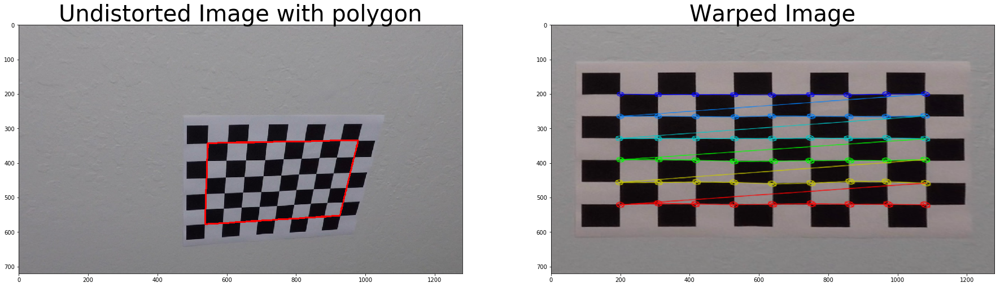

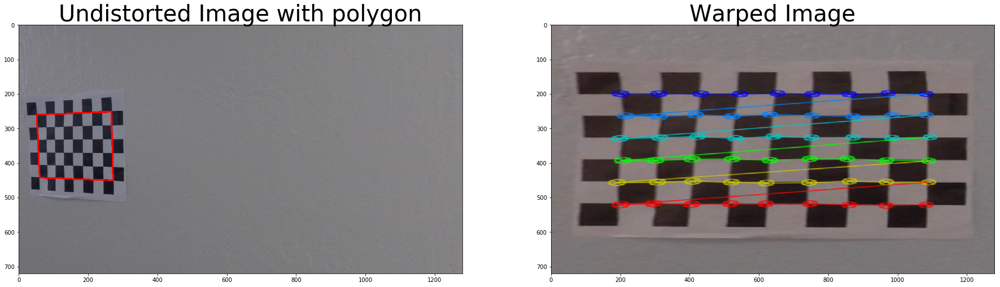

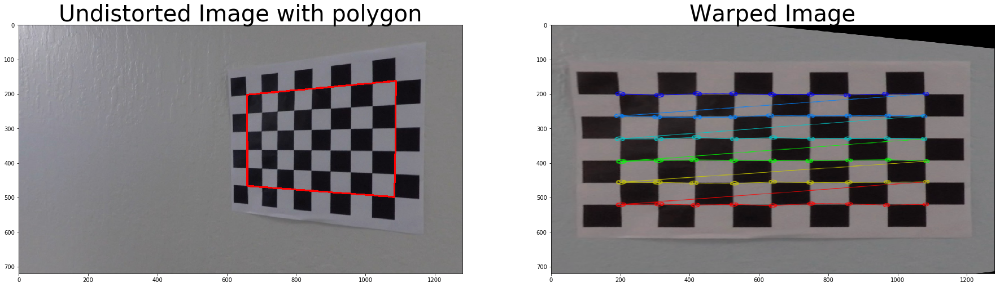

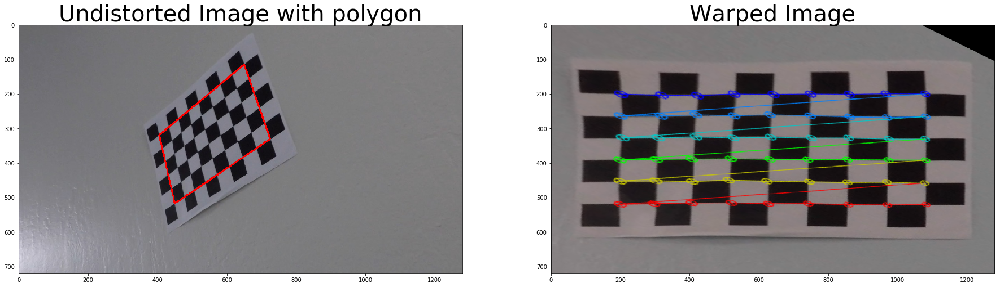

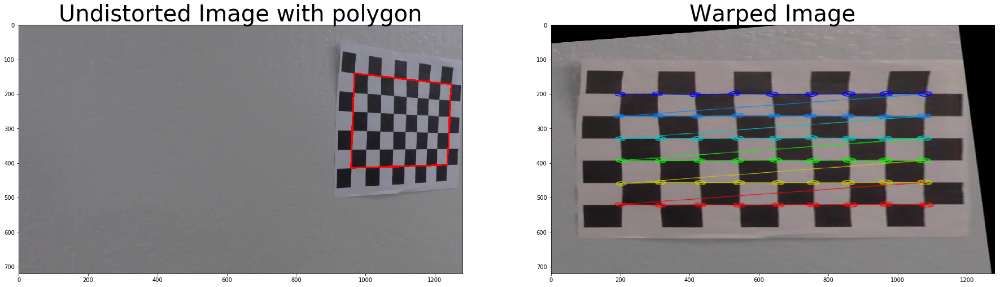

...

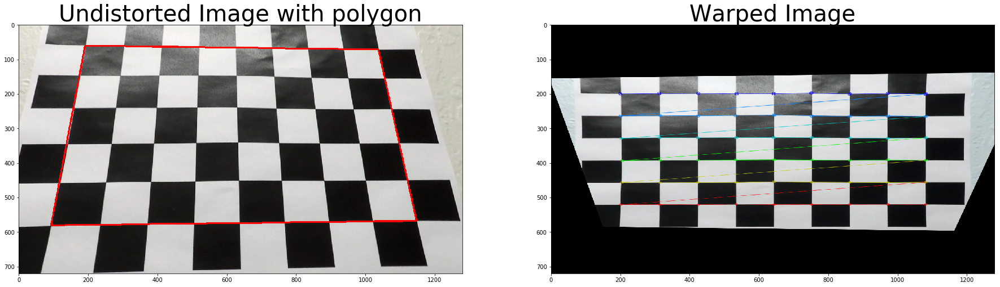

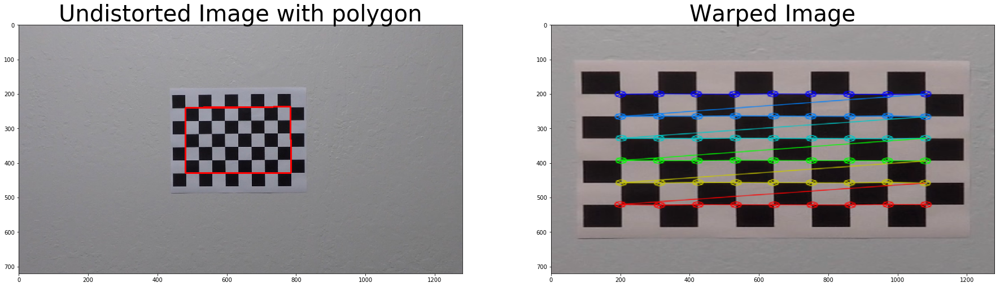

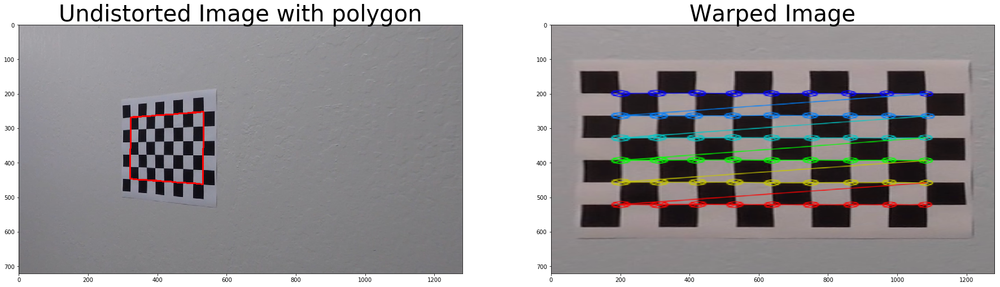

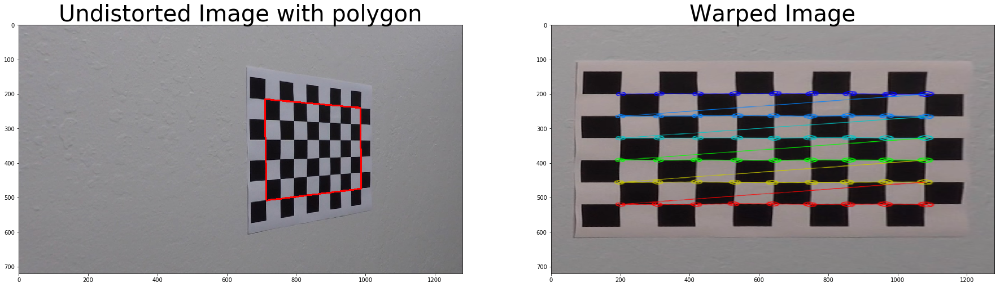

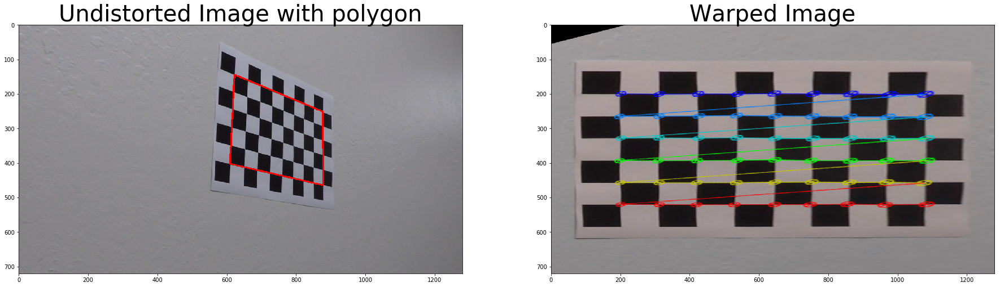

In [214]:
TEST_FOLDER = "./test_images/"
OUTPUT_FOLDER = "./output_images/"
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
nx = 9
ny = 6
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

imgs = []
for fname in images:
    img = cv2.imread(fname)
    imgs.append(img)
    generate_image_points(img, fname)

# Calibrate camera
mtx, dst = calibrate_cam(objpoints, imgpoints)

for idx, fname in enumerate(images):
    undistorted_fname = fname.split("/")[-1].replace("calibration", "undistorted")
    undist = undistort(imgs[idx], mtx, dst, undistorted_fname)
    warped_fname = undistorted_fname.replace("undistorted", "warped")
    original_with_lines, warped, M, Minv = warp(undist, warped_fname)
    if warped is not None:
        plotDiff(original_with_lines, warped, "Undistorted Image with polygon", "Warped Image")


## Test it on test images

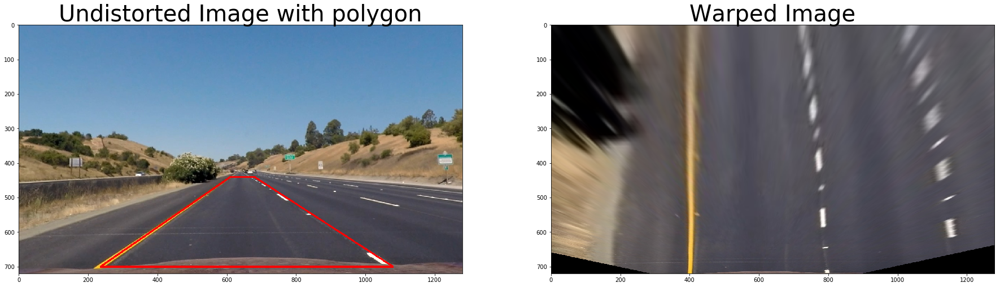

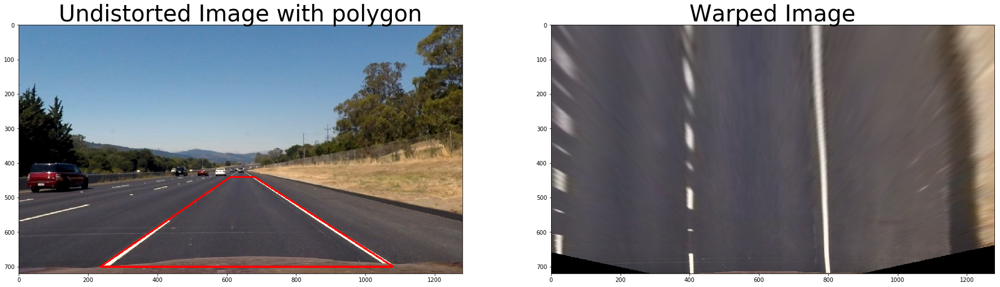

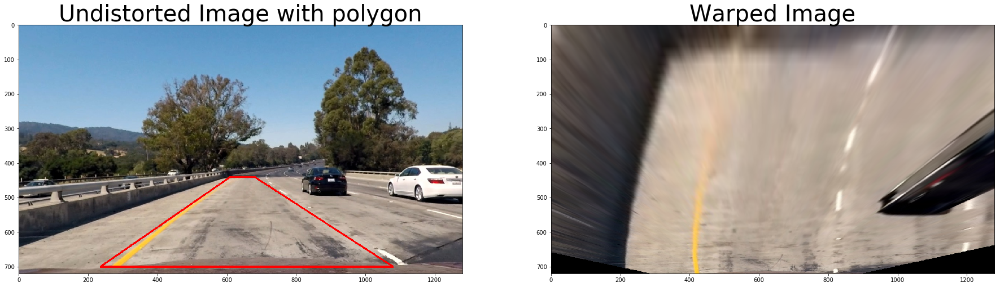

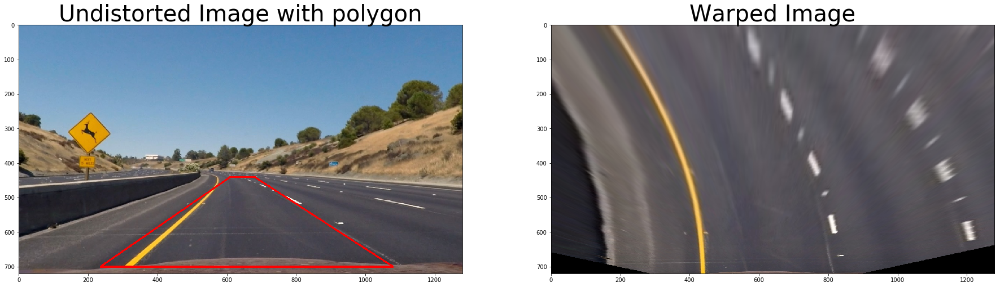

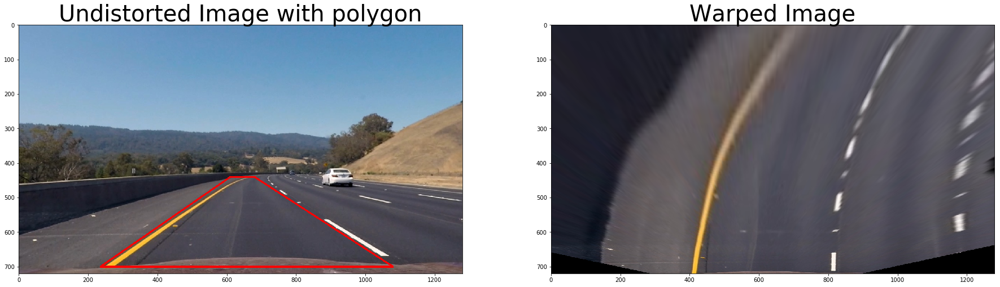

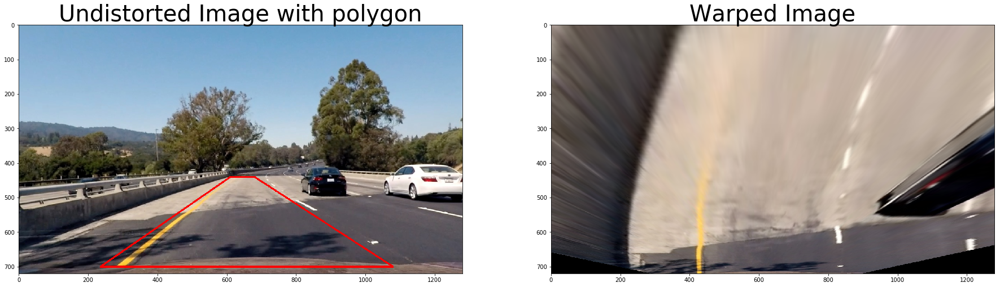

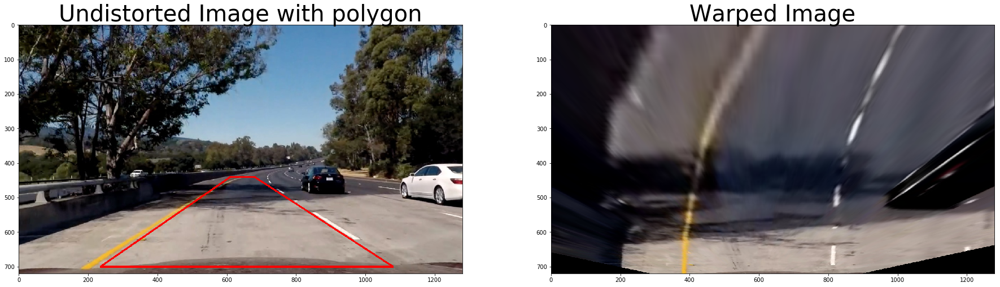

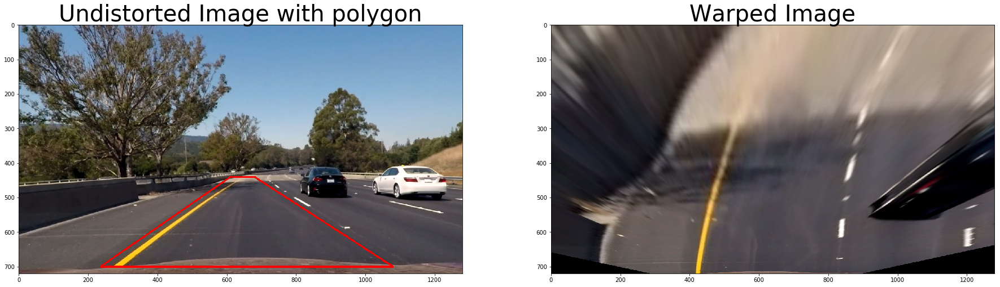

In [217]:
img_size = (1280, 720)
src = np.float32([[235, 700], [1080, 700], [680, 440], [610, 440]])
dest = np.float32([[400, 720], [800, 720], [800, 0], [400, 0]])

# Try it on straight lines
images = glob.glob('./test_images/straight_lines*.jpg')
for fname in images:
    img = cv2.imread(fname)
    # Calibrate camera
    mtx, dst = calibrate_cam(objpoints, imgpoints)
    undistorted_fname = "undistorted_" + fname.split("/")[-1]
    undist = undistort(img, mtx, dst, undistorted_fname)
    warped_fname = "warped_" + fname.split("/")[-1]
    img_size = (img.shape[1], img.shape[0])
    original_with_lines, warped, M, Minv = warp(undist, warped_fname, src = src, dst = dest)
    if warped is not None:
        plotDiff(original_with_lines, cv2.cvtColor(warped, cv2.COLOR_BGR2RGB), "Undistorted Image with polygon", "Warped Image")

# Try it on curves, using same bounding rectangle
images = glob.glob('./test_images/test*.jpg')
for fname in images:
    img = cv2.imread(fname)
    # Calibrate camera
    mtx, dst = calibrate_cam(objpoints, imgpoints)
    undistorted_fname = "undistorted_" + fname.split("/")[-1]
    undist = undistort(img, mtx, dst, undistorted_fname)
    warped_fname = "warped_" + fname.split("/")[-1]
    original_with_lines, warped, M, Minv = warp(undist, warped_fname, src = src, dst = dest)
    if warped is not None:
        plotDiff(original_with_lines, cv2.cvtColor(warped, cv2.COLOR_BGR2RGB), "Undistorted Image with polygon", "Warped Image")



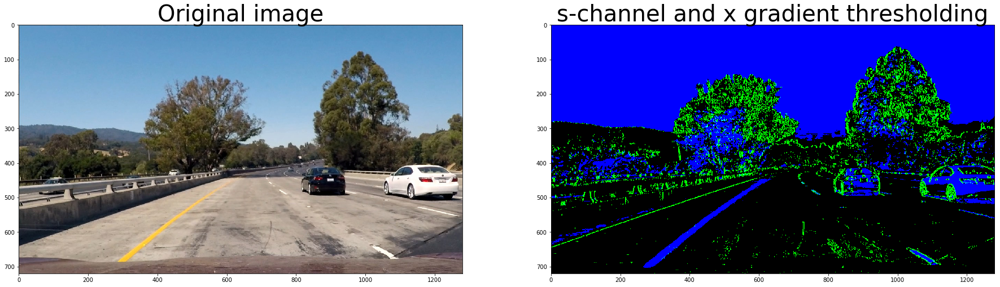

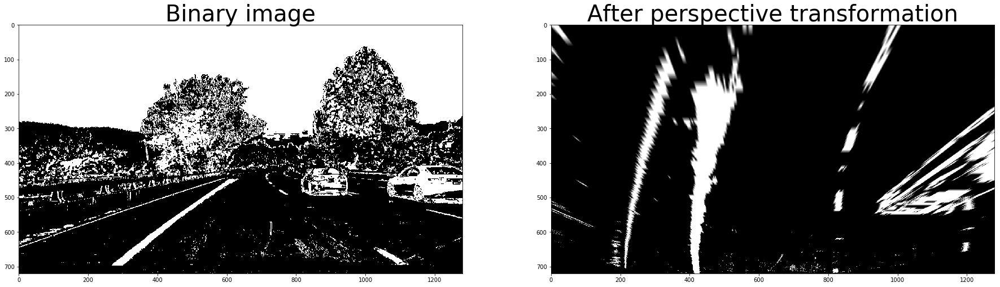

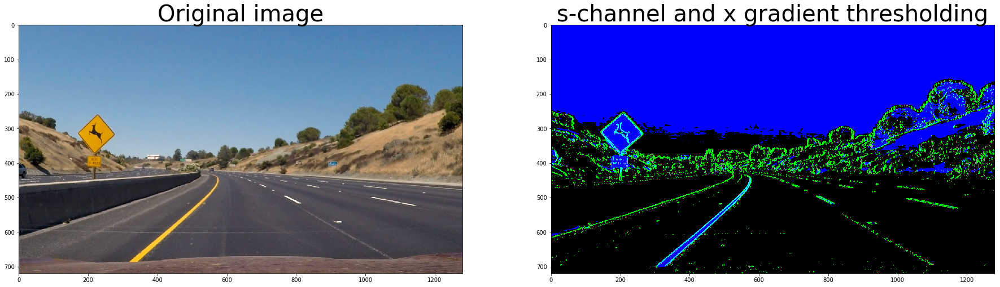

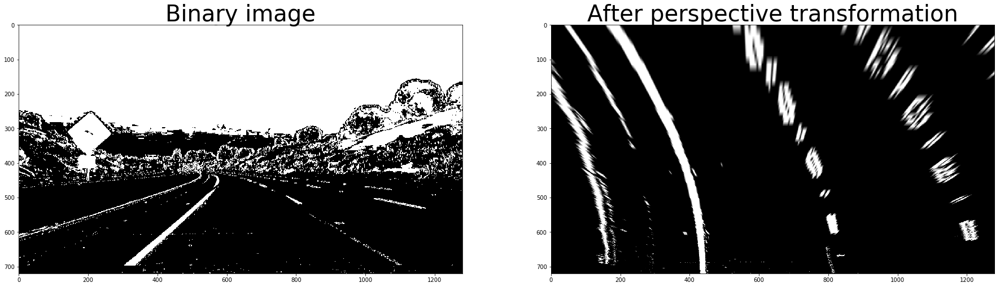

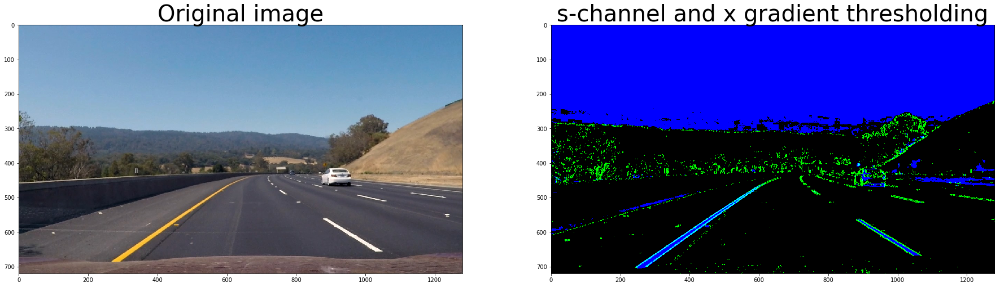

...

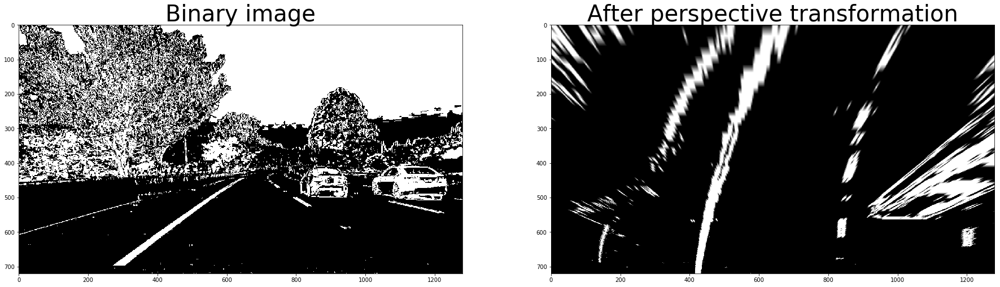

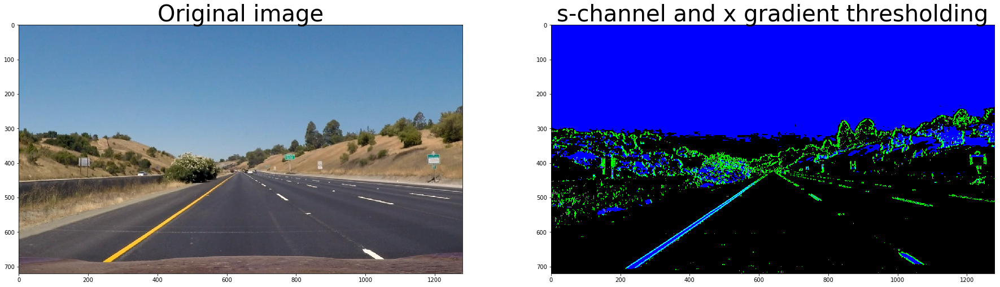

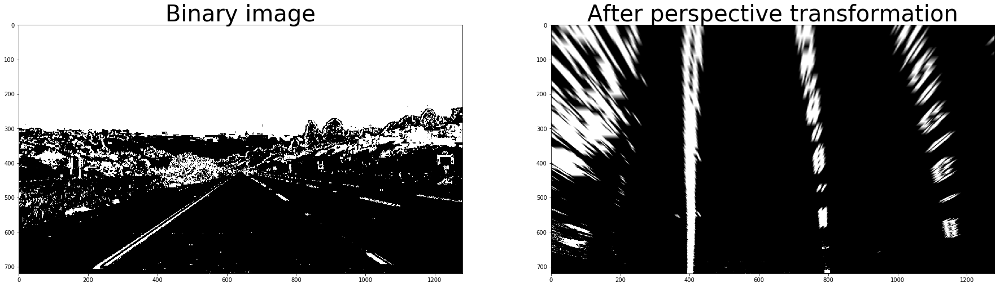

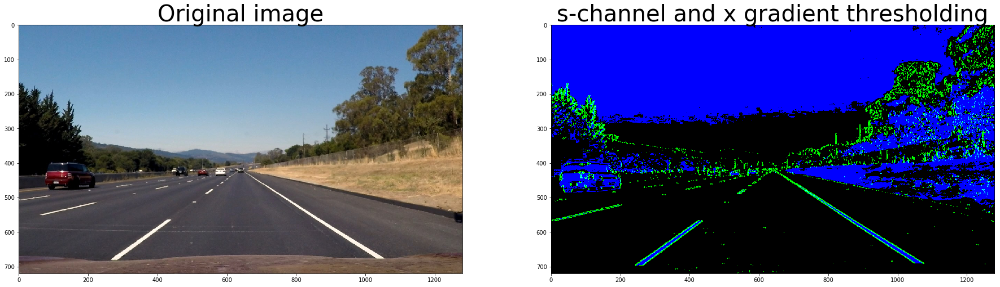

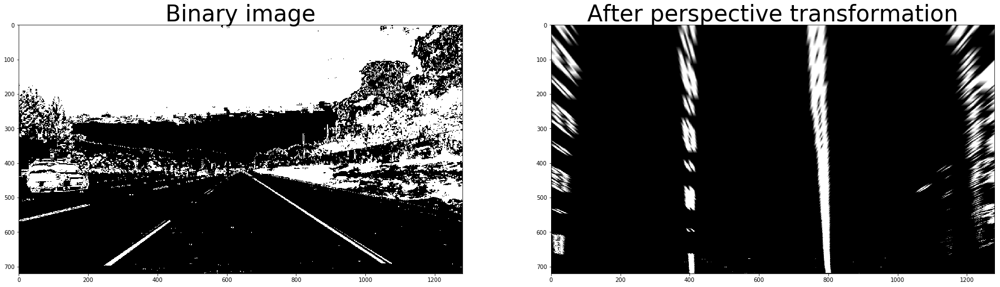

In [219]:

def color_and_gradient_thresholding(img, s_thresh=(90,255), sx_thresh=(20, 255)):
    img = np.copy(img)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    l_channel = hls[:,:,1]
    # sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255 * abs_sobelx/ np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel
    color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    # binary merged
    binary_merged = np.zeros_like(s_binary)
    binary_merged[(s_binary == 1) | (sxbinary == 1)] = 255
    
    return (color_binary.astype(np.uint8), binary_merged.astype(np.uint8)) 

images = glob.glob("./test_images/test*.jpg") + glob.glob("./test_images/straight_lines*.jpg")
thresholded_warped_images = []
for fname in images:
    img = cv2.imread(fname)
    undist = undistort(img, mtx, dst, None)
    color_binary, binary_merged = color_and_gradient_thresholding(undist)
    warped_fname = "binary_thresholding_warped_" + fname.split("/")[-1]
    original_with_lines, warped, M, Minv = warp(binary_merged, warped_fname, src = src, dst = dest)
    plotDiff(img, color_binary, "Original image", "s-channel and x gradient thresholding")
    plotDiff(original_with_lines, warped, "Binary image", "After perspective transformation")
    thresholded_warped_images.append((fname.split("/")[-1], warped))
    
    
    
    

## Finding lane lines: peaks in histogram

sliding_window_test1.jpg: Left curve: 278.74m , Right curve: 252.11m
sliding_window_test2.jpg: Left curve: 173.49m , Right curve: 262.62m
sliding_window_test3.jpg: Left curve: 187.68m , Right curve: 173.08m
sliding_window_test4.jpg: Left curve: 307.19m , Right curve: 204.32m
sliding_window_test5.jpg: Left curve: 142.34m , Right curve: 121.36m
sliding_window_test6.jpg: Left curve: 1554.29m , Right curve: 166.57m
sliding_window_straight_lines1.jpg: Left curve: 2360.75m , Right curve: 1799.23m
sliding_window_straight_lines2.jpg: Left curve: 8380.48m , Right curve: 7215.08m


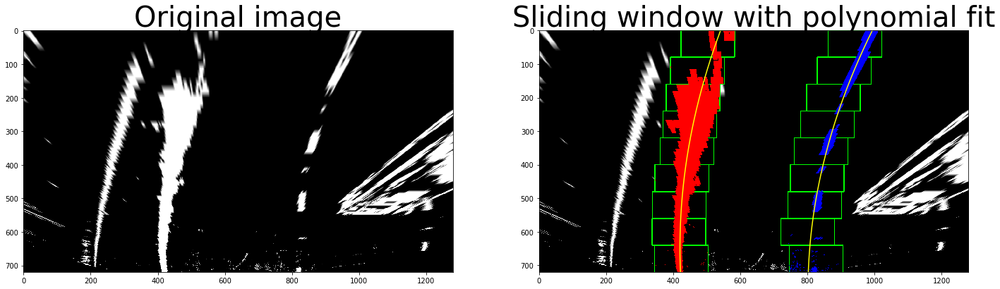

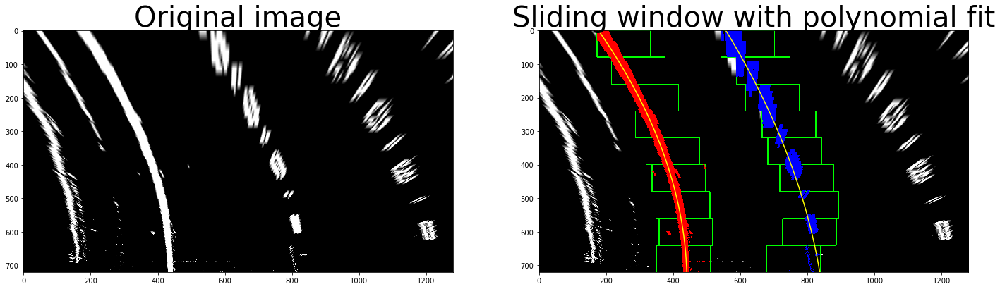

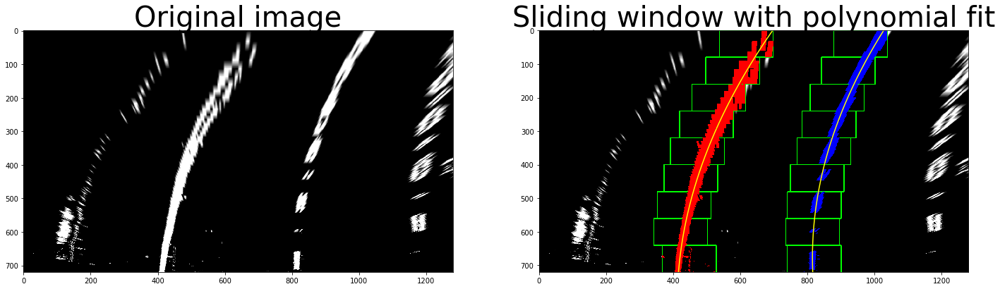

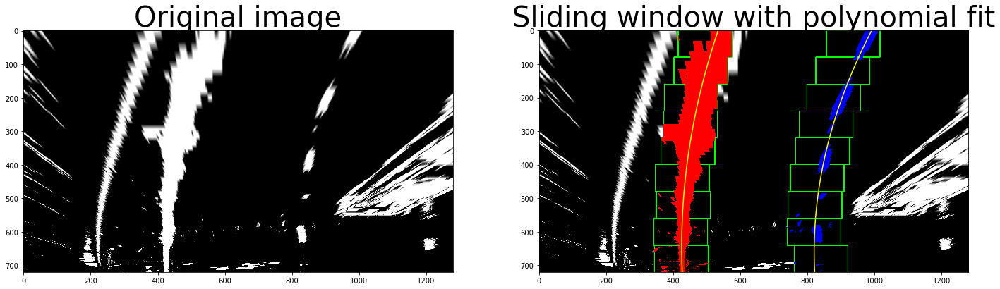

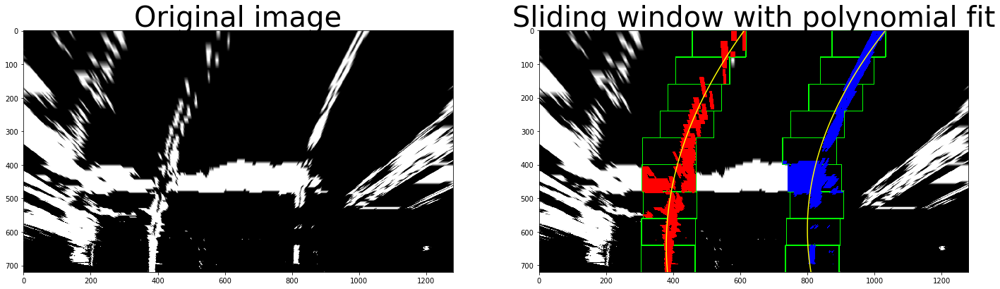

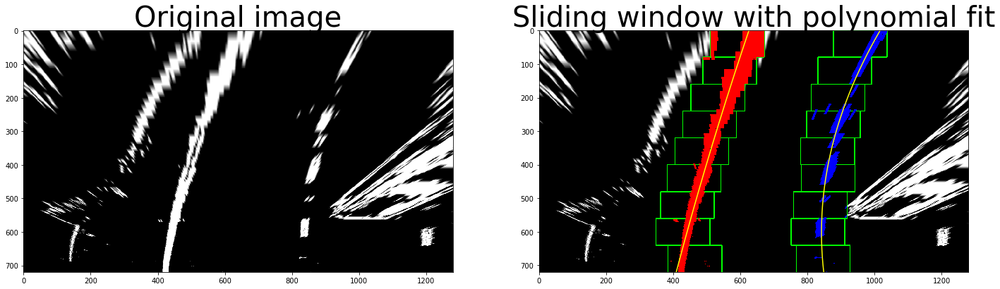

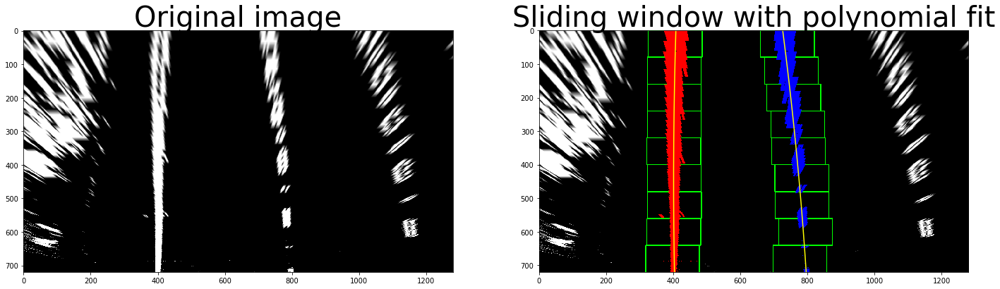

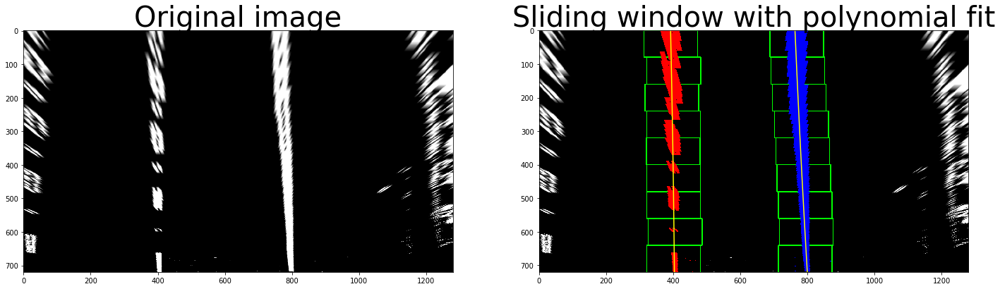

In [220]:
# binary_warped is a (height, width) float32 binary image
# Pass in fname and save = True to save to output folder
def find_lane_lines(binary_warped, fname, plot=False, save=False, draw_windows=False):
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    #plt.plot(histogram)
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped))*255).astype(np.uint8)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    
    # Constraint leftx and rightx base to a window between leftx_left_boundary:midpoint and midpoint:rightx_right_boundary
    leftx_left_boundary = 300
    rightx_right_boundary = 1000
    leftx_base = np.argmax(histogram[leftx_left_boundary:midpoint]) + leftx_left_boundary
    rightx_base = np.argmax(histogram[midpoint:rightx_right_boundary]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        if draw_windows: cv2.rectangle(out_img,(win_xleft_low, win_y_low),(win_xleft_high, win_y_high), (0,255,0), 2)
        if draw_windows: cv2.rectangle(out_img,(win_xright_low, win_y_low),(win_xright_high, win_y_high), (0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Define a converson in x and y for conversion from pixel space to meters
    ym_per_px = 30 / 780
    xm_per_px = 3.7 / 400
    
    # Fit a second order polynomial to x,y in real world coordinates
    left_fit_cr = np.polyfit(lefty*ym_per_px, leftx*xm_per_px, 2)
    right_fit_cr = np.polyfit(righty*ym_per_px, rightx*xm_per_px, 2)
    
    # Evaluate at bottom of the image
    y_eval = out_img.shape[0]-1
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_px + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_px + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    

    # Fit a second order polynomial in pixel space
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    ptsLeft = np.int32(list(zip(left_fitx, ploty)))
    ptsRight = np.int32(list(zip(right_fitx, ploty)))

    # visualization
    if plot: 
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        ax1.imshow(binary_warped, cmap='gray')
        ax2.imshow(out_img)
        ax1.set_title("Original image", fontsize=40)
        ax2.set_title("Sliding window with polynomial fit", fontsize=40)
        ax2.plot(left_fitx, ploty, color='yellow')
        ax2.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
    else:
        # Draw on the actual image itself
        cv2.polylines(out_img, [ptsLeft], 0, (0,255,0), thickness = 20)
        cv2.polylines(out_img, [ptsRight], 0, (0,255,0), thickness = 20)
        
    if save:
        cv2.imwrite(OUTPUT_FOLDER + fname, out_img)
    
    return left_fit_cr, right_fit_cr, left_curverad, right_curverad, ptsLeft, ptsRight, out_img

# Determine offset from center of the lane
def calc_dist_from_center(left_curve, right_curve):
    pass

# Test find_lane_lines
for fname, img in thresholded_warped_images:
    img = img.astype(np.float32) / 255
    fname = "sliding_window_" + fname
    left_fit, right_fit, left_curve, right_curve, ptsLeft, ptsRight, out_img = find_lane_lines(img, fname, plot=True, save=True, draw_windows=True)
    print("%s: Left curve: %.2fm , Right curve: %.2fm" % (fname, left_curve, right_curve))
    

## Let's build a end-to-end pipeline and try it on videos!

In [150]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [280]:
# Transform lane lines in the warped image and draw them on the original image
def inverse_transform(img, ptsLeft, ptsRight, Minv):
    ptsLeft = ptsLeft.astype(np.float32)
    ptsRight = ptsRight.astype(np.float32)
    transformedLeft = cv2.perspectiveTransform(ptsLeft[None, :, :], Minv).astype(np.int32)
    transformedRight= cv2.perspectiveTransform(ptsRight[None, :, :], Minv).astype(np.int32)
    transformed = np.concatenate((transformedLeft, transformedRight[:,::-1])).reshape(-1,1,2)
    lane_area = np.zeros_like(img)
    cv2.fillConvexPoly(lane_area, transformed, (0,255,0))
    blended = cv2.addWeighted(img,0.7,lane_area,0.3,0)
    cv2.polylines(blended, transformedLeft, 0, (255,0,0), thickness = 10)
    cv2.polylines(blended, transformedRight, 0, (0,0,255), thickness = 10)
    return blended

def process_image(img):
    # Undistort
    undist = undistort(img, mtx, dst, None)
    # Color and gradient thresholding
    color_binary, binary_merged = color_and_gradient_thresholding(undist)
    # Perspective transform
    original_with_lines, warped, M, Minv = warp(binary_merged, None, src = src, dst = dest)
    # rescale output because find_lane_lines takes in float32 binary image
    warped = warped.astype(np.float32) / 255 
    # Find lane lines using sliding window
    left_fit, right_fit, left_curve, right_curve, ptsLeft, ptsRight, out_img = find_lane_lines(warped, fname, plot=False, save=False, draw_windows=False)
    dist_from_center = calc_dist_from_center(left_curve, right_curve)
    original_with_lane_boundaries = inverse_transform(img, ptsLeft, ptsRight, Minv)
    
    output_with_curve_data = draw_text(original_with_lane_boundaries, left_curve, right_curve)
    return original_with_lane_boundaries

In [281]:
project_video = './project_video.mp4'
project_video_output = "./project_video_output.mp4"
clip1 = VideoFileClip(project_video).subclip(0,4)
# clip1 = VideoFileClip(project_video)
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video ./project_video_output.mp4
[MoviePy] Writing video ./project_video_output.mp4


 99%|█████████▉| 100/101 [00:20<00:00,  4.98it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_output.mp4 

CPU times: user 19.8 s, sys: 4.07 s, total: 23.9 s
Wall time: 22.9 s


In [282]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video_output))